**Author: Svenja Gaedcke**  
gaedcke.svenja@mh-hannover.de  
06.12.2021  

# Setup

In [1]:
%matplotlib inline
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import sys
import os
import numpy as np
import pandas as pd
import scanpy as sc
import datetime
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (4,4)
from matplotlib import rcParams
import seaborn as sb

#Read config file
import configparser as config
config = config.ConfigParser()
config.read('./config.ini')
#os.chdir(config['PATHS']["OUTPUT"])

sc.settings.verbosity = 0        
sc.logging.print_versions()
sc.settings.figdir = config['PATHS']["OUTPUT"]+"/figs/"
sc._settings.n_jobs = 5
sc._settings.max_memory = 80 #GB
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=600,
                         frameon=True, vector_friendly=True, 
                         fontsize=14, color_map=None, format='pdf',
                         transparent=True)
sc._settings.savefigs = False

-----
anndata     0.7.4
scanpy      1.5.1
sinfo       0.3.1
-----
PIL                 7.2.0
anndata             0.7.4
anyio               NA
attr                21.2.0
babel               2.9.0
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
brotli              NA
cairo               1.19.1
certifi             2020.06.20
cffi                1.14.2
chardet             3.0.4
cloudpickle         1.2.2
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
dask                2.10.1
dateutil            2.8.1
decorator           4.4.2
get_version         2.1
google              NA
h5py                2.10.0
idna                2.10
igraph              0.8.2
importlib_metadata  1.7.0
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.2
jinja2              2.11.2
joblib              1.1.0
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyterlab_server   2.3.0
kiwisolve

# Read Data

In [2]:
results_file = config['PATHS']["DATA"]+'/results_kidney_N1532_N1538.h5ad'  
filenames = [
    config['PATHS']["DATA"]+"/N1532_N1538/outs/filtered_feature_bc_matrix/",
    config['PATHS']["DATA"]+"/N1533_N1539/outs/filtered_feature_bc_matrix/", 
    config['PATHS']["DATA"]+"/N1534_N1540/outs/filtered_feature_bc_matrix/"]
sample_string = ["N1532_N1538", "N1533_N1539", "N1534_N1540"]
sample_description= ["cell_control", "cell_17min", "cells_27min"]
sample_id = ["0","1","2"]
marker_gene_file= config['PATHS']["DATA"]+"/KideyMarkerGenes.txt"

#read first data
adata = sc.read_10x_mtx(filenames[0], var_names="gene_symbols", cache=True)
adata.obs["sample"] = [sample_string[0]]*adata.n_obs
adata.obs["sample_description"] =  [sample_description[0]]*adata.n_obs
adata.obs["batch"] = ["batch_0"]*adata.n_obs
adata.var_names_make_unique() 
print(adata)

#read additional data
for index,filepath in enumerate(filenames[1:], start=1):
    print(index, filepath)
    adata_tmp = sc.read_10x_mtx(filepath, var_names="gene_symbols", cache=True)
    adata_tmp.obs["sample"] = [sample_string[index]]*adata_tmp.n_obs
    adata_tmp.obs["sample_id"] = [str(index)]*adata_tmp.n_obs
    adata_tmp.obs["sample_description"] =  [sample_description[index]]*adata_tmp.n_obs
    adata_tmp.obs["batch"] = ["batch_"+str(index)]*adata_tmp.n_obs
    adata_tmp.var_names_make_unique() 
    
    #concatenate to main data
    adata = adata.concatenate(adata_tmp, batch_key='sample_id')
    adata.obs.drop(columns=['sample_id'], inplace=True)

AnnData object with n_obs × n_vars = 13934 × 31053
    obs: 'sample', 'sample_description', 'batch'
    var: 'gene_ids', 'feature_types'
1 /mnt/dzl_bioinf/deluca/kidney/N1533_N1539/outs/filtered_feature_bc_matrix/
2 /mnt/dzl_bioinf/deluca/kidney/N1534_N1540/outs/filtered_feature_bc_matrix/


In [3]:
raw_cellnumber = len(adata.obs)

# Preprocessing:

In [4]:
adata.var["mt"] = adata.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

In [5]:
#QC with set thresholds:
sc.pp.filter_cells(adata, min_genes=200) #remove cell if less then 200 genes in cell expressed
sc.pp.filter_genes(adata, min_cells=3)   #remove gene if less then 3 cells express the gene
#determine thresholds:
#add cell size as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1

mito_genes = adata.var_names.str.startswith('mt-') # get mt genes
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1

In [6]:
print("Counts per Cell: ",np.mean(adata.obs['n_counts']))
print("Counts per Cell: ",np.mean(adata.obs['total_counts']))
print("Genes per Cell: ",np.mean(adata.obs['n_genes']))

Counts per Cell:  5336.5786
Counts per Cell:  5336.6704
Genes per Cell:  1456.302751344642


In [7]:
#filtering by Thresholds:
print(adata[adata.obs.n_genes >= 8000, :].shape[0], " cells were removed with more then 8,000 genes expressed")
adata = adata[adata.obs.n_genes < 8000, :]

print("% of removed cells by filtering:", (raw_cellnumber-len(adata.obs))/raw_cellnumber*100 )

print("%mt per gene (mean):", np.mean(adata.obs.percent_mito)*100)
print(adata[adata.obs.percent_mito >= 0.15, :].shape[0], " cells were removed with more then 15% mt genes")
adata = adata[adata.obs.percent_mito < 0.15, :]

print("Counts per Cell: ",np.mean(adata.obs['n_counts']))
print("Counts per Cell: ",np.mean(adata.obs['total_counts']))
print("Genes per Cell: ",np.mean(adata.obs['n_genes']))

print("% of removed cells by filtering and mt:", (raw_cellnumber-len(adata.obs))/raw_cellnumber*100 )

5  cells were removed with more then 8,000 genes expressed
% of removed cells by filtering: 10.7183264448498
%mt per gene (mean): 26.32860541343689
18376  cells were removed with more then 15% mt genes
Counts per Cell:  4609.672
Counts per Cell:  4609.7754
Genes per Cell:  1539.7026760632793
% of removed cells by filtering and mt: 53.14830635664642


In [8]:
#normalize per cell:
sc.pp.normalize_total(adata, exclude_highly_expressed =True)

#log:
sc.pp.log1p(adata)
adata.raw = adata # save current data (normlaized and log-transformed) as raw 

/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


## Douplets

N1532_N1538
Preprocessing...


/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


Trying to set attribute `.obs` of view, copying.


Automatically set threshold at doublet score = 0.29
Detected doublet rate = 2.4%
Estimated detectable doublet fraction = 69.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 3.5%
Elapsed time: 2.4 seconds


... storing 'sample' as categorical
... storing 'sample_description' as categorical
... storing 'batch' as categorical
... storing 'feature_types' as categorical


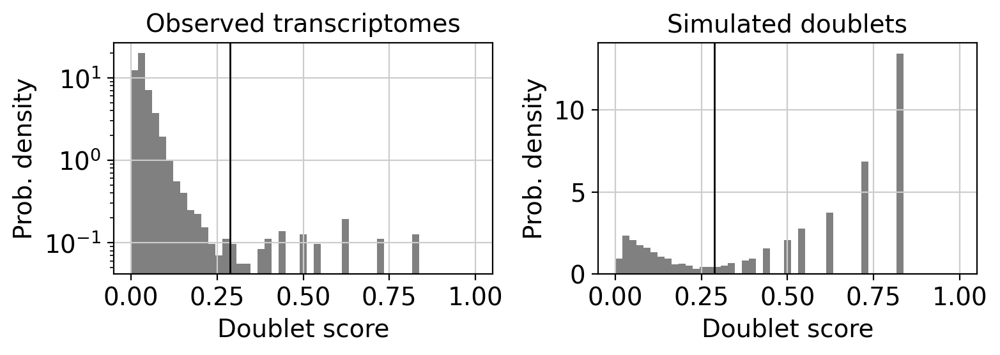

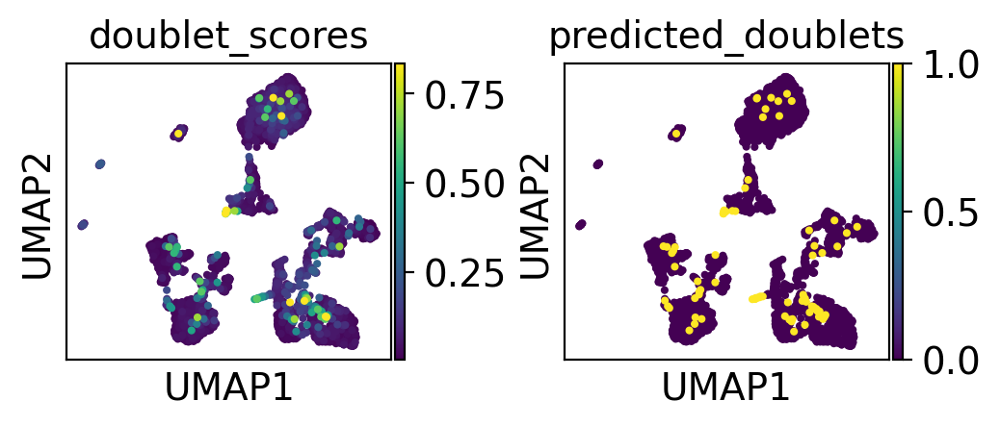

N1533_N1539
Preprocessing...


/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:251: RuntimeWarning: invalid value encountered in sqrt
  CV_eff = np.sqrt((1+a)*(1+b) - 1);
/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


Trying to set attribute `.obs` of view, copying.


Automatically set threshold at doublet score = 0.21
Detected doublet rate = 7.1%
Estimated detectable doublet fraction = 76.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 9.3%
Elapsed time: 9.8 seconds


... storing 'sample' as categorical
... storing 'sample_description' as categorical
... storing 'batch' as categorical
... storing 'feature_types' as categorical


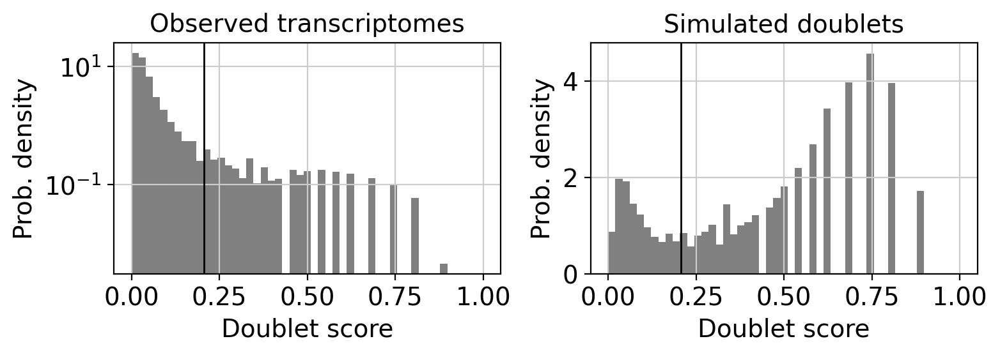

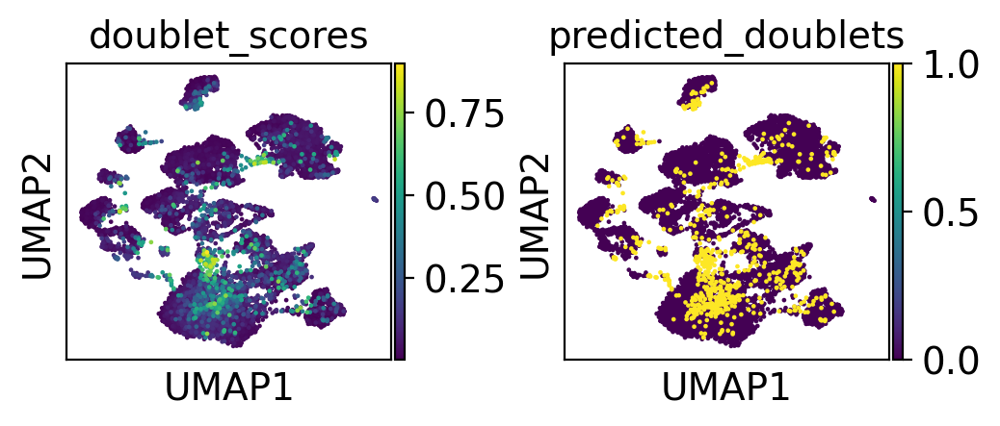

N1534_N1540
Preprocessing...


/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])
/mnt/dzl_bioinf/exec/miniconda/miniconda3/envs/scRNA/lib/python3.7/site-packages/scrublet/helper_functions.py:252: RuntimeWarning: invalid value encountered in sqrt
  CV_input = np.sqrt(b);


Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...


Trying to set attribute `.obs` of view, copying.


Automatically set threshold at doublet score = 0.31
Detected doublet rate = 3.1%
Estimated detectable doublet fraction = 67.6%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 4.6%
Elapsed time: 5.4 seconds


... storing 'sample' as categorical
... storing 'sample_description' as categorical
... storing 'batch' as categorical
... storing 'feature_types' as categorical


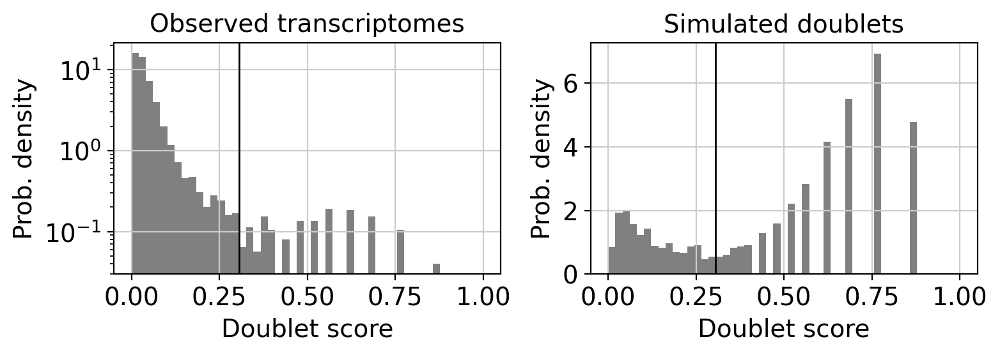

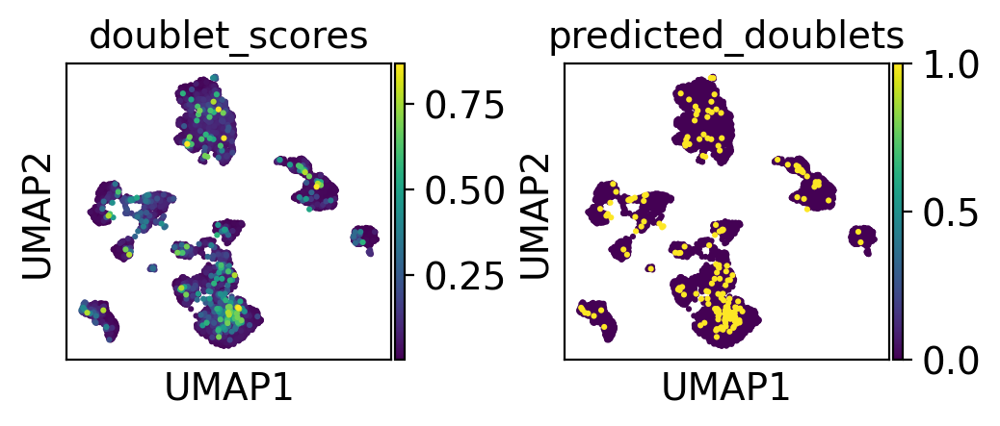

... storing 'sample' as categorical
... storing 'sample_description' as categorical
... storing 'batch' as categorical
... storing 'feature_types' as categorical


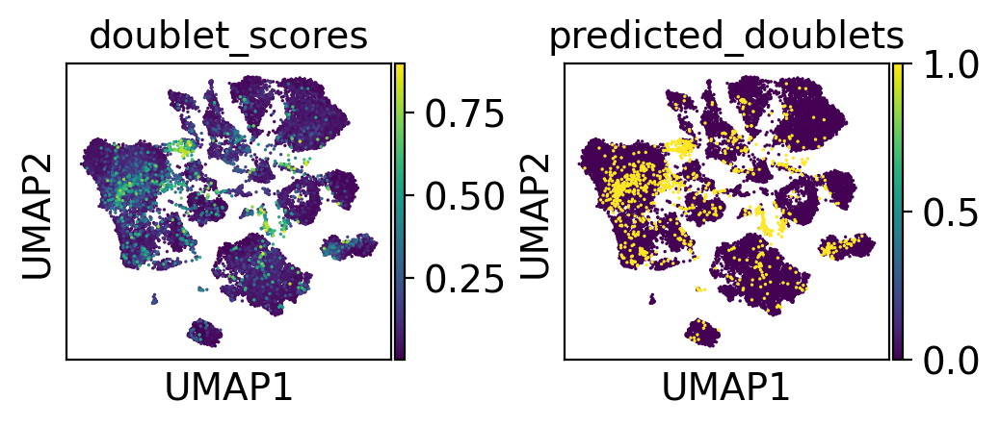

In [9]:
import scrublet as scr
plt.rcParams['figure.figsize']=(2,2)
adata.obs['predicted_doublets']= False
adata.obs['doublet_scores']= 0
for s in np.unique(adata.obs["sample"]):
    print(s)
    adt = adata[adata.obs["sample"]==s]
    scrub = scr.Scrublet(adt.X)
    adt.obs['doublet_scores'], adt.obs['predicted_doublets'] = scrub.scrub_doublets(n_prin_comps=24)
    scrub.plot_histogram()
    sc.pp.neighbors(adt)
    sc.tl.umap(adt)
    sc.pl.umap(adt, color=['doublet_scores','predicted_doublets'])
    adata.obs.loc[adata.obs["sample"]==s, "predicted_doublets"] = adt.obs['predicted_doublets']
    adata.obs.loc[adata.obs["sample"]==s, "doublet_scores"] = adt.obs['doublet_scores']

del adt
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.pl.umap(adata, color=['doublet_scores','predicted_doublets'])

In [10]:
#remove douplets
adata = adata[adata.obs['predicted_doublets'].astype("str") == 'False',:]
print(adata.shape)

(19263, 20514)


In [11]:
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

Trying to set attribute `.obs` of view, copying.


## Batch

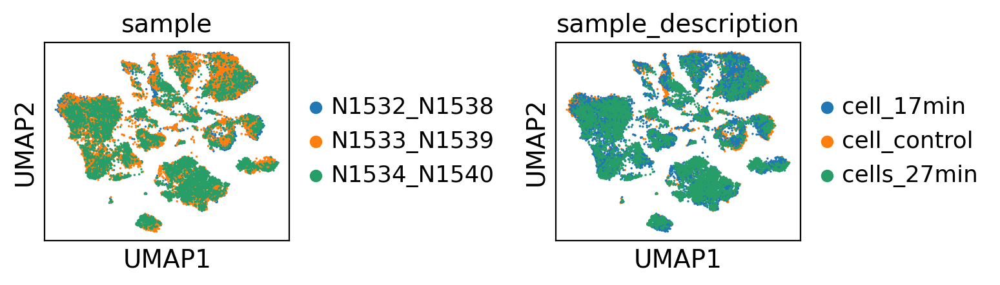

In [12]:
sc.pl.umap(adata, color=["sample", "sample_description"], wspace=0.9)

In [13]:
sc.external.pp.harmony_integrate(adata, 'sample')

2022-08-23 19:48:25,387 - harmonypy - INFO - Iteration 1 of 10
Iteration 1 of 10
2022-08-23 19:48:32,964 - harmonypy - INFO - Iteration 2 of 10
Iteration 2 of 10
2022-08-23 19:48:42,434 - harmonypy - INFO - Iteration 3 of 10
Iteration 3 of 10
2022-08-23 19:48:51,162 - harmonypy - INFO - Iteration 4 of 10
Iteration 4 of 10
2022-08-23 19:48:56,979 - harmonypy - INFO - Iteration 5 of 10
Iteration 5 of 10
2022-08-23 19:49:00,365 - harmonypy - INFO - Converged after 5 iterations
Converged after 5 iterations


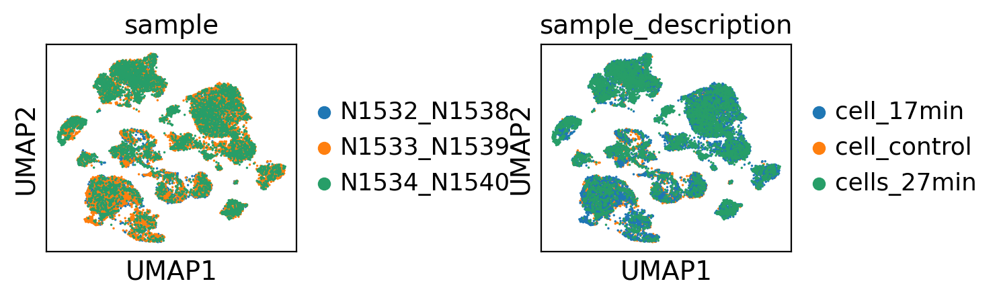

In [14]:
sc.pp.neighbors(adata, use_rep='X_pca_harmony', key_added="neighbors_harmony")
sc.tl.umap(adata, neighbors_key="neighbors_harmony" )
sc.pl.umap(adata, color=["sample", "sample_description"], wspace=0.8)

# Clustering:

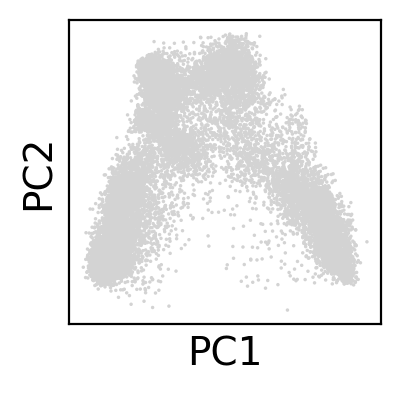

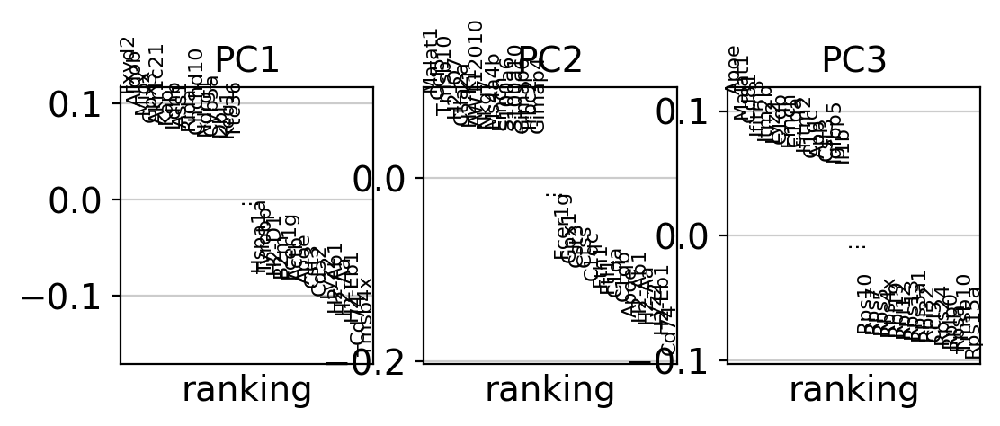

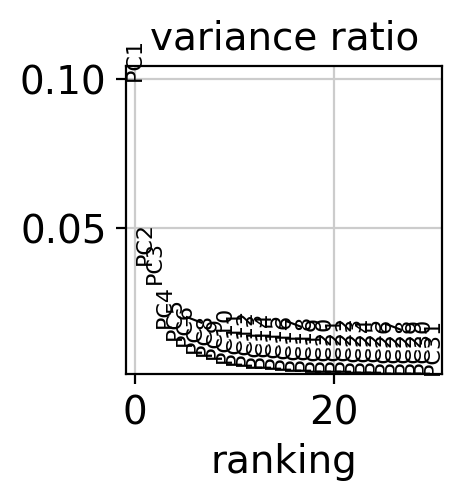

In [15]:
sc.tl.pca(adata, svd_solver='arpack')
plt.rcParams['figure.figsize']=(2,2)
sc.pl.pca_overview(adata)

In [16]:
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=10 ,use_rep='X_pca_harmony')
sc.tl.louvain(adata, resolution=1.3)

In [17]:
adata.obs["n_counts_log"] = np.log(adata.obs["n_counts"])

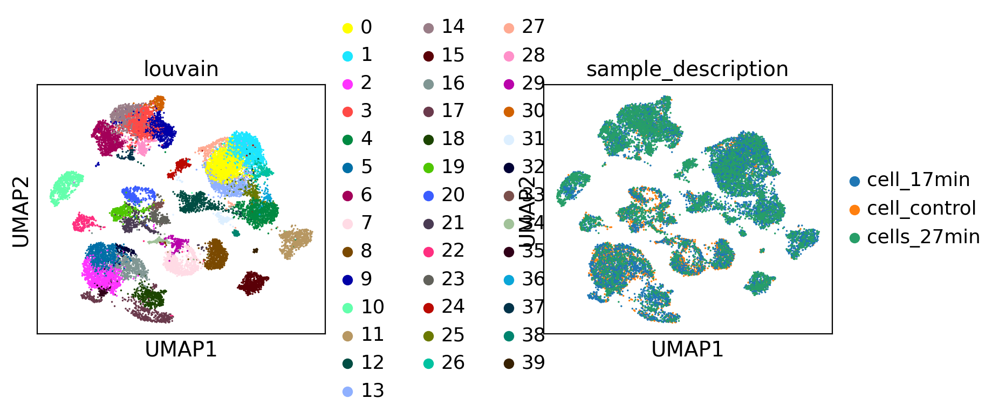

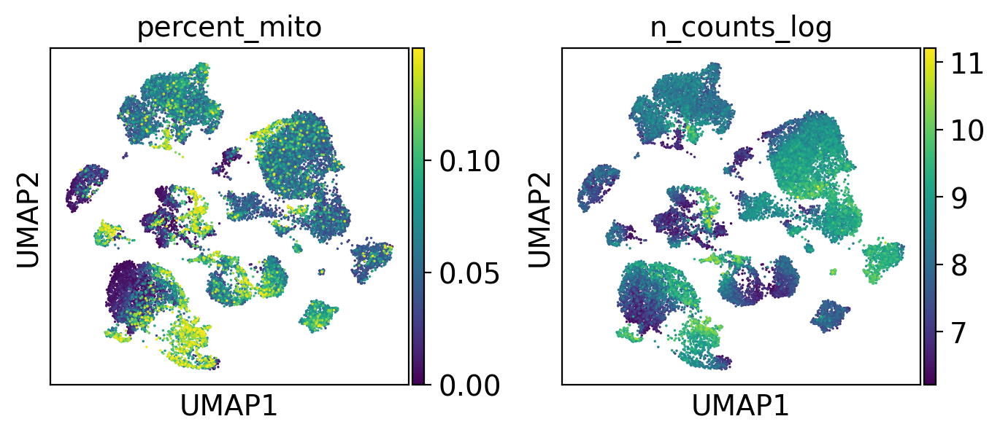

In [18]:
plt.rcParams['figure.figsize']=(3,3)
sc.pp.neighbors(adata, use_rep='X_pca_harmony', key_added="neighbors_harmony")
sc.tl.umap(adata, neighbors_key="neighbors_harmony")
sc.pl.umap(adata ,color=["louvain","sample_description"], wspace=0.6)#, save="_sc_sample.pdf")
sc.pl.umap(adata, color=['percent_mito',"n_counts_log"], wspace=0.3)

## number of cells per cluster

In [19]:
adata.obs['louvain'].value_counts()
pd. set_option('display.max_rows', None) 
adata.obs.groupby(["louvain", "sample_description"]).count()["sample"]

louvain  sample_description
0        cell_17min            1083
         cell_control           197
         cells_27min            417
1        cell_17min             932
         cell_control           238
         cells_27min            320
2        cell_17min             484
         cell_control           385
         cells_27min            152
3        cell_17min             483
         cell_control            89
         cells_27min            415
4        cell_17min             576
         cell_control            37
         cells_27min            335
5        cell_17min             315
         cell_control           330
         cells_27min            164
6        cell_17min             367
         cell_control            42
         cells_27min            400
7        cell_17min             300
         cell_control           375
         cells_27min            129
8        cell_17min             309
         cell_control           249
         cells_27min            131


# Celltype Annoation
## annoate with markergenes

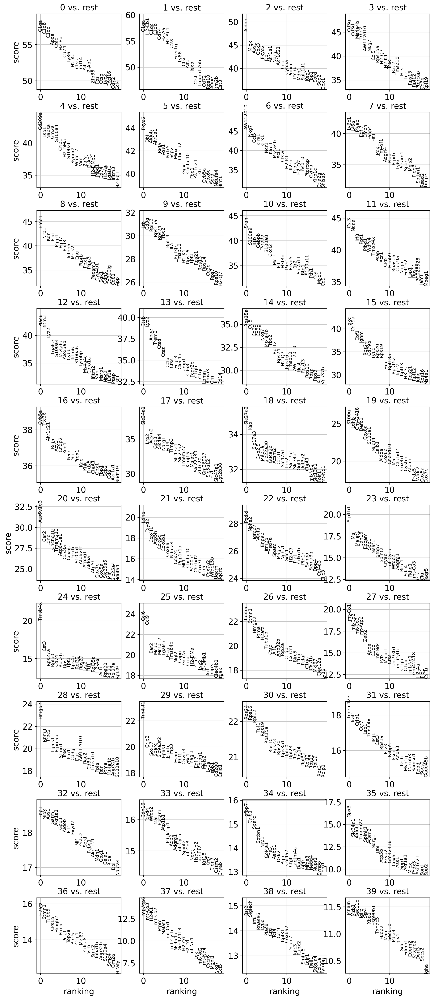

In [20]:
sc.tl.rank_genes_groups(adata, 'louvain', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

In [21]:
filelist = [ f for f in os.listdir(config["PATHS"]["OUTPUT"]+"/Markergenes/") if "sc_" in f ]
for f in filelist:
    os.remove(os.path.join(config["PATHS"]["OUTPUT"]+"/Markergenes/", f))

In [22]:
#Export calculated Markers (DGE)
result = adata.uns['rank_genes_groups']
cluster = result['names'].dtype.names
result
for c in cluster:
    df = pd.DataFrame({key: result[key][c]
    for key in ['names','logfoldchanges','pvals','pvals_adj']})
    #df.to_csv(config["PATHS"]["OUTPUT"]+'/Markergenes/'+c+"_sc_markergenes.csv")

## Literature Marker

In [23]:
markergenes = pd.read_csv(config["PATHS"]["DATA"]+"/KideyMarkerGenes.txt", sep="\t")[["Type","Gene"]]
marker_dict = dict()
for celltype in np.unique(markergenes.Type):
    l = list(markergenes[markergenes["Type"] == celltype].Gene)
    l = [g for g in l if g in adata.var_names]
    marker_dict[celltype] = l

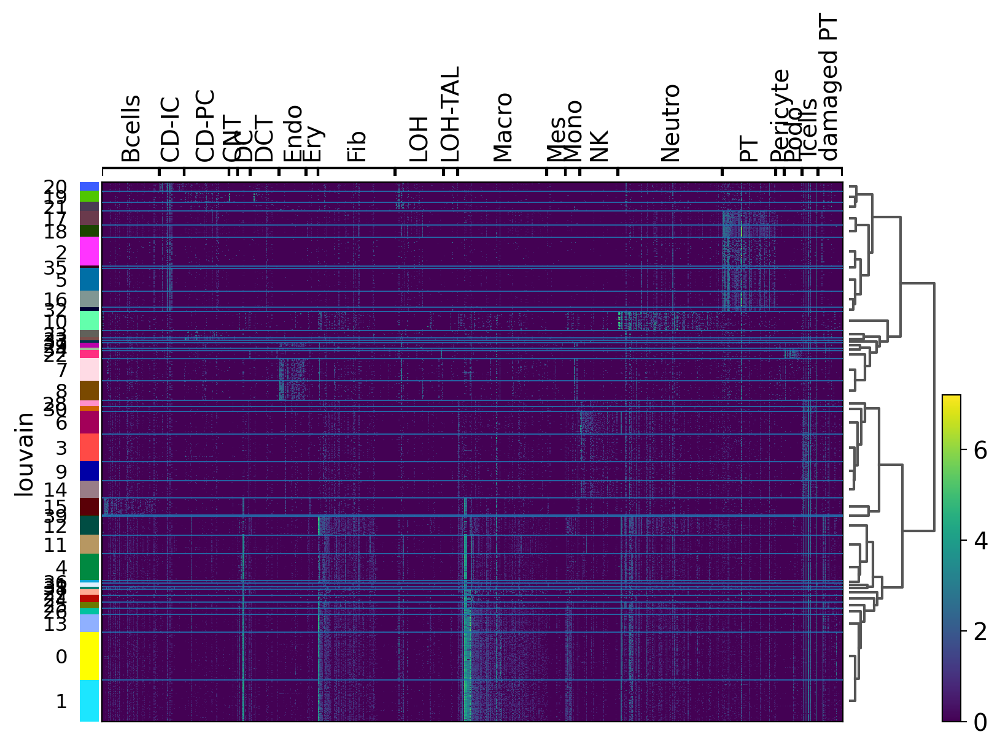

In [24]:
sc.pl.heatmap(adata, marker_dict, groupby="louvain", use_raw=True, dendrogram=True)

In [25]:
marker_dict_light = {
    "CD-IC":['Atp6v1g3', 'Atp6v0d2'],    
    'CD-PC':['Aqp2','Hsd11b2'],
    'CNT':["Trpv5"],
    'DCT':["Slc12a3","Slc12a1", "Calb1"],
    'Endo':['Kdr',"Nrp1","Egfl7", "Flt1"],
    'Ery':['Alas2', 'Cd36', 'Cd44'],
    'Fib':["Plac8","S100a4","Eln","Dcn"],
    'LOH':["Slc12a1", "Aqp1","Sptssb"],
    'LOH-TAL':['Slc12a1', 'Smarcd3'], 
    'Mes':['Arid5b', 'Ccr7'], 
    'PT':["Apoe",'Slc34a1',"Myh11","Spp2","Lrp2", "Slc5a2","Slc2a2"],  
    'Pericyte':['Acta2', 'Alpl'], 
    'Podo':['Nphs2','Nphs1'],    
    'damaged PT':["Havcr1"], 
    
    "Bcells":['Cd79a','Cd79b',"Cd81"],
    'Tcells':["Cd3g","Cd3e", "Thy1"],
    'Macro':['Adgre1',"C1qa","C1qb","C1qc","Cd74","Batf3"],
    'DC':[ 'Ccl17', 'Cd14'],
    'NK':['Gzma', 'Nkg7', "Tyrobp"],
    'Mono':["Adgre1",'Ccr2', 'Cd14', 'Cd44',"Pdgfrb"],
    'Neutro':['S100a8', 'S100a9']
}


marker_dict_light2 = {    
    "B":['Cd79a'],
    "CD-IC":['Atp6v1g3'],    
    'CD-PC':['Aqp2'],
    'DC':[ 'S100g'],
    'Endo':["Egfl7"],
    'LOH':["Umod", "Slc12a1"],   
    'Mes':['Pdgfrb'], 
    'NK':['Gzma'],
    'Neutro':['S100a8'],
    'PT':["Lrp2"],  
    'Podo':['Nphs2'],   
    'T':["Cd3g"], 
    'damaged PT':["Havcr1"], 
    "u":["Ccr7"],
    "ΜΦ":["C1qa"]  ,
    "DCT":["Slc12a3"],  
    "DC/Mono":["Itgax"],
    "Macro": ["Cx3cr1"]
}


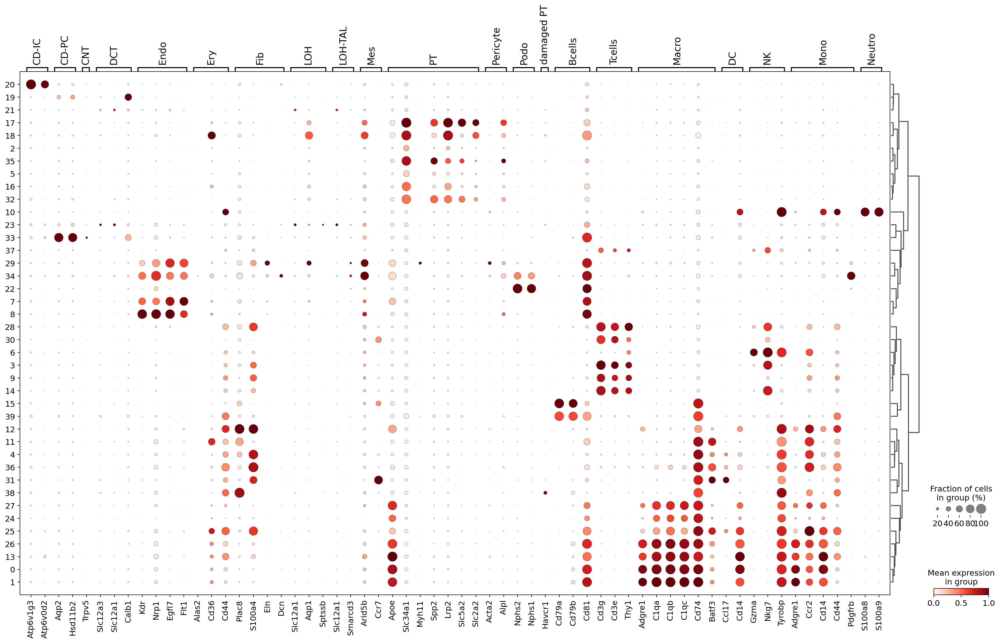

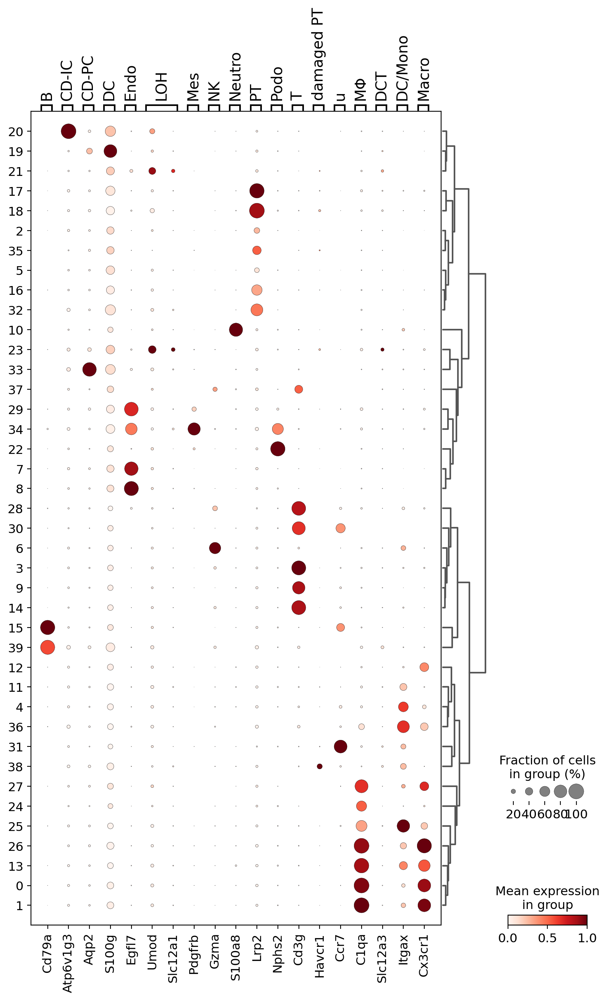

In [26]:
sc.pl.dotplot(adata, marker_dict_light, groupby='louvain', dendrogram=True, use_raw=True, standard_scale ="var")
sc.pl.dotplot(adata, marker_dict_light2, groupby='louvain', dendrogram=True, use_raw=True, 
              standard_scale ="var")

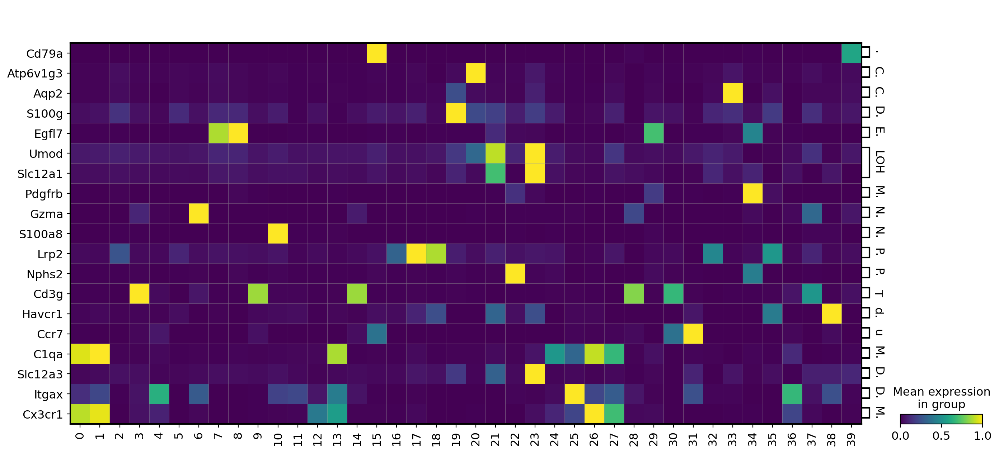

In [27]:
sc.pl.matrixplot(adata, groupby="louvain",                        
                var_names = marker_dict_light2,
                standard_scale="var",swap_axes =True)

## final annotation

In [28]:
new_cluster_names = ['ΜΦ','ΜΦ1','PT','T','DC','PT1','NK','Endo','Endo1','T2','Neutro',
                     'DC1','ΜΦ2','ΜΦ3','T3','B','PT2','PT3','PT4','CNT','CDIC','LOH','Podo',
                     'LOH2','ΜΦ4','ΜΦ5','ΜΦ6','ΜΦ7','T4','Endo2','T5','DC3','PT5','CDPC','Mes',
                     'PT6','DC2','T6','damagedPT','B2']
                     
adata.obs["celltype"] = adata.obs["louvain"]
adata.rename_categories('celltype', new_cluster_names)

In [29]:
old_to_new = dict(
    ΜΦ='ΜΦ',
    ΜΦ1='ΜΦ',
    PT='PT',
    T='T',
    DC='DC',
    PT1='PT',
    NK='NK',
    Endo='Endo',
    Endo1='Endo',
    T2='T',
    Neutro='Neutro',
    DC1='DC',
    ΜΦ2='ΜΦ',
    ΜΦ3='ΜΦ',
    T3='T',
    B='B',
    PT2='PT',
    PT3='PT',
    PT4='PT',
    CNT='CNT',
    CDIC='CD-IC',
    LOH='LOH',
    Podo='Podo',
    LOH2='LOH',
    ΜΦ4='ΜΦ',
    ΜΦ5='ΜΦ',
    ΜΦ6='ΜΦ',
    ΜΦ7='ΜΦ',
    T4='T',
    Endo2='Endo',
    T5='T',
    DC3='DC',
    PT5='PT',
    CDPC='CD-PC',
    Mes='Mes',
    PT6='PT',
    DC2='DC',
    T6='T',
    damagedPT = 'damaged PT',
    B2='B'
)

adata.obs['celltype'] = (
    adata.obs['celltype']
    .map(old_to_new)
    .astype('category'))

In [30]:
celltypes = ['Endo', 'CD-IC', 'PT', 'B', 'NK', 'Macro', 'CD-PC', 'Fib', 'T',
             'Neutro', 'DCT', 'ΜΦ', 'Podo', 'Mes', 'damaged PT', 'LOH', "others", "DC", "CNT"]
colors = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2', 
          '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5', '#c49c94',
          '#f7b6d2',"#cffc03", "#32a86d","#d142eb"]

colors = dict(zip(celltypes, colors))
adata.obs["celltype"] = adata.obs["celltype"].cat.reorder_categories( ['Endo', 'CD-IC', 'PT', 'B',
                                                                       'NK',  'CD-PC',  'T',
             'Neutro', 'ΜΦ', 'Podo', 'damaged PT', 'LOH',  "DC","CNT",'Mes' ])

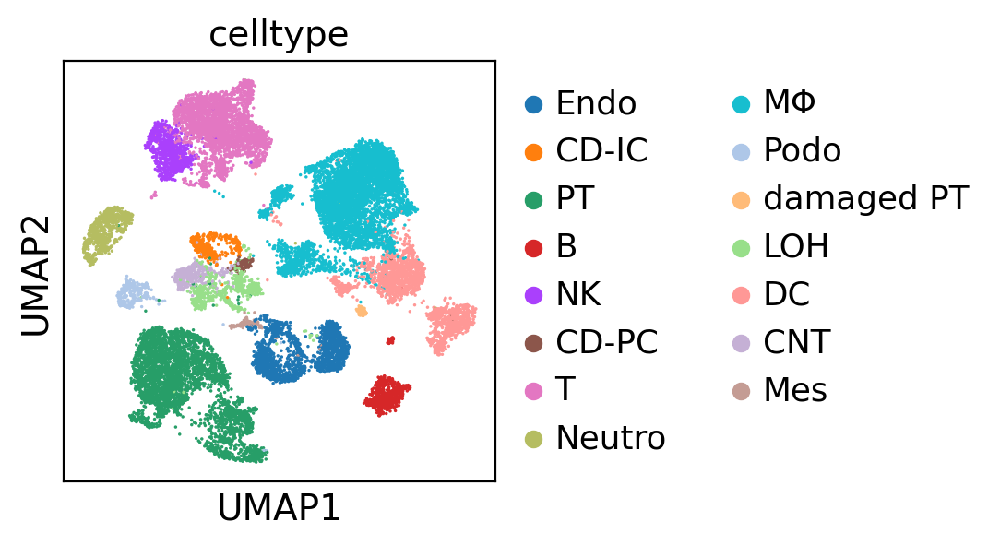

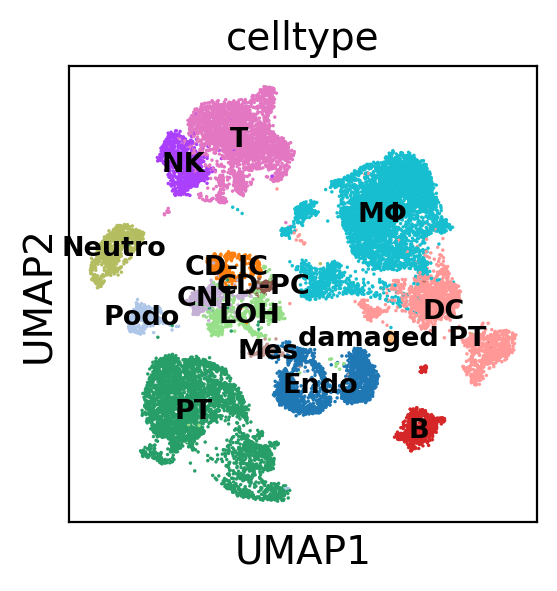

In [31]:
sc.pl.umap(adata, color="celltype")
sc.pl.umap(adata, color="celltype",legend_loc ="on data", legend_fontsize  ="x-small")#, save="_sc_celltypes.pdf")

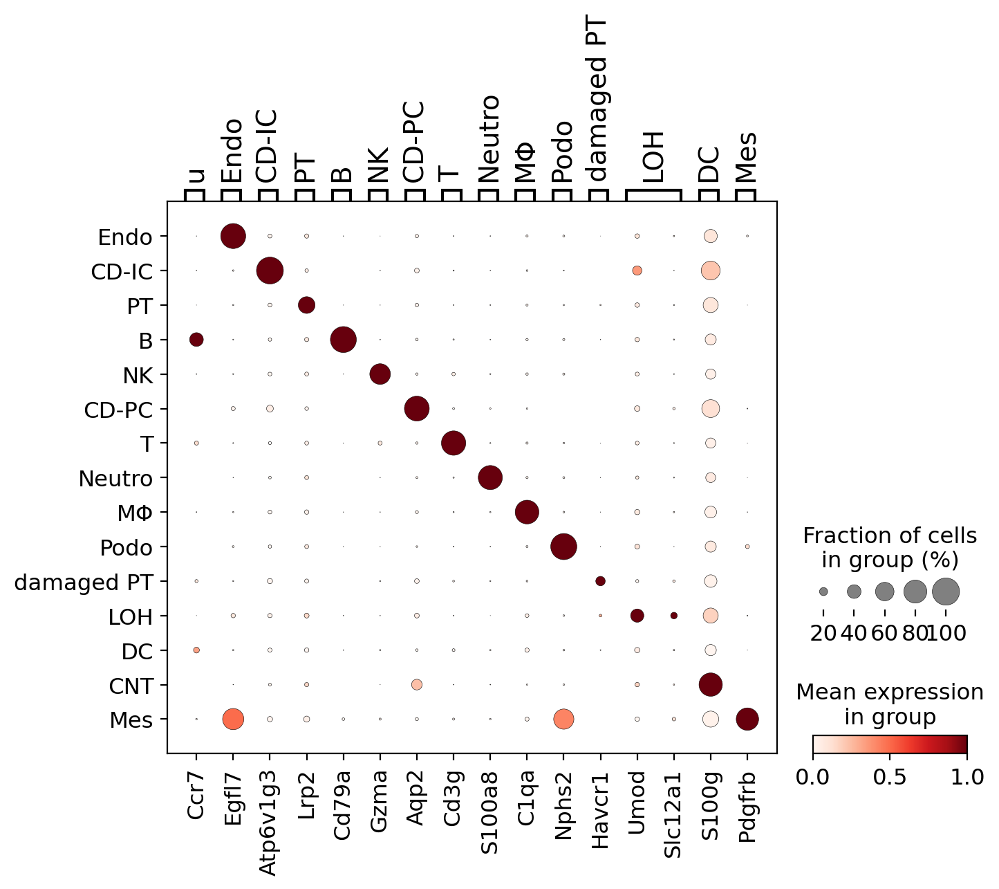

In [32]:
marker_dict_light2 = {
    "u":["Ccr7"],
    'Endo':["Egfl7"],
    "CD-IC":['Atp6v1g3'], 
    'PT':["Lrp2"],   
    "B":['Cd79a'],   
    'NK':['Gzma'],
    'CD-PC':['Aqp2'],    
    'T':["Cd3g"], 
    'Neutro':['S100a8'], 
   # "DCT":["Slc12a3"], 
    "ΜΦ":["C1qa"] , 
    'Podo':['Nphs2'],
    'damaged PT':["Havcr1"],  
    'LOH':["Umod", "Slc12a1"],    
    'DC':[ 'S100g'],
    'Mes':['Pdgfrb'], 
}
    
sc.pl.dotplot(adata, marker_dict_light2, groupby='celltype', dendrogram=False, use_raw=True,
              standard_scale ="var")#, save="_sc.pdf")

In [33]:
pt= ["PT","damaged PT"]
adata_pt = adata[adata.obs['celltype'].isin(pt)]

In [34]:
print("number of features/cell or nucleus per cell type")
adata.obs['n_counts2'] = adata.X.sum(axis=1).A1
adata.obs.groupby(["celltype"]).mean()[["n_counts"]]

number of features/cell or nucleus per cell type


,n_counts
celltype,
Endo,2527.494629
CD-IC,3896.764404
PT,4844.867188
B,2733.984619
NK,2926.210205
CD-PC,9873.030273
T,3225.632324
Neutro,1658.108276
ΜΦ,5469.616699


In [35]:
print("Numbers of cells per timepoint:")
adata.obs.groupby(["sample_description"]).count()["sample"]

Numbers of cells per timepoint:


sample_description
cell_17min      9894
cell_control    3440
cells_27min     5929
Name: sample, dtype: int64

In [36]:
print("Numbers of cells per celltype and timepoint:")
adata.obs.groupby(["celltype", "sample_description"]).count()["sample"]

Numbers of cells per celltype and timepoint:


celltype    sample_description
Endo        cell_17min             689
            cell_control           694
            cells_27min            297
CD-IC       cell_17min             148
            cell_control           134
            cells_27min             45
PT          cell_17min            1807
            cell_control          1167
            cells_27min            604
B           cell_17min             321
            cell_control            74
            cells_27min            252
NK          cell_17min             367
            cell_control            42
            cells_27min            400
CD-PC       cell_17min              42
            cell_control            37
            cells_27min             21
T           cell_17min            1278
            cell_control           223
            cells_27min           1260
Neutro      cell_17min             298
            cell_control            18
            cells_27min            358
ΜΦ          cell_17min           

In [37]:
print("Numbers of cells per celltype:")
adata.obs.groupby(["celltype"]).count()["sample"]

Numbers of cells per celltype:


celltype
Endo          1680
CD-IC          327
PT            3578
B              647
NK             809
CD-PC          100
T             2761
Neutro         674
ΜΦ            5402
Podo           284
damaged PT      73
LOH            587
DC            1859
CNT            393
Mes             89
Name: sample, dtype: int64

In [38]:
print("Numbers of cells per celltype:")
adata.obs["celltype"] = adata.obs["celltype"].astype(str)

adata.obs.groupby(["celltype"]).count()["sample"]

Numbers of cells per celltype:


celltype
B              647
CD-IC          327
CD-PC          100
CNT            393
DC            1859
Endo          1680
LOH            587
Mes             89
NK             809
Neutro         674
PT            3578
Podo           284
T             2761
damaged PT      73
ΜΦ            5402
Name: sample, dtype: int64

## Umap per timepoint
### control

In [39]:
adata_c = adata[adata.obs.sample_description =="cell_control"] 

... storing 'celltype' as categorical


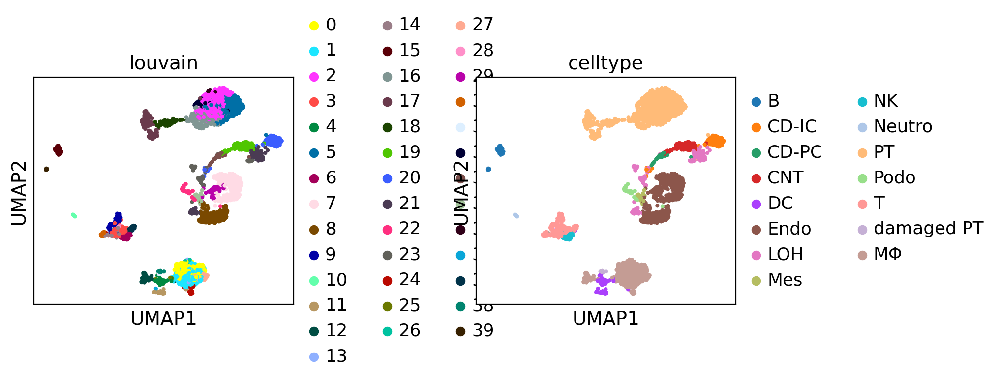

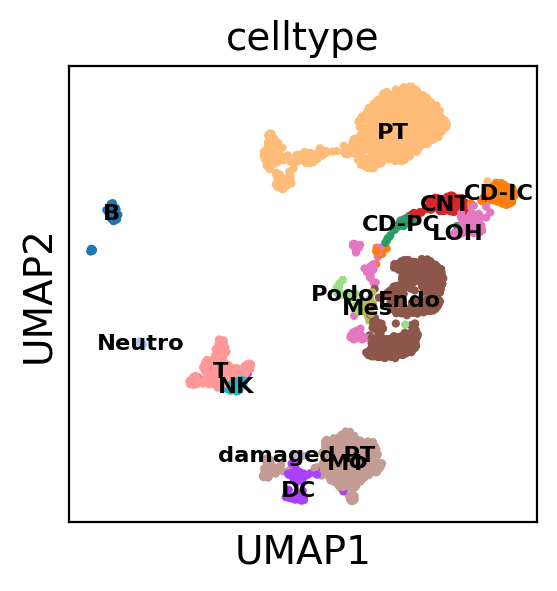

In [40]:
sc.tl.pca(adata_c, svd_solver='arpack')
sc.pp.neighbors(adata_c)
sc.tl.umap(adata_c)
sc.pl.umap(adata_c,color=["louvain","celltype"],wspace=0.55)
sc.pl.umap(adata_c ,color=["celltype"],wspace=0.55,legend_loc ="on data",
 legend_fontsize ="xx-small")#, save="_sc_c.pdf")

Numbers of cells per celltype:
others (smaller groups): 
Empty DataFrame
Columns: [celltype, sample]
Index: []
              celltype  cells       %
celltype                             
B                    B     74   2.15%
CD-IC            CD-IC    134    3.9%
CD-PC            CD-PC     37   1.08%
CNT                CNT    135   3.92%
DC                  DC     85   2.47%
Endo              Endo    694  20.17%
LOH                LOH    177   5.15%
Mes                Mes     33   0.96%
NK                  NK     42   1.22%
Neutro          Neutro     18   0.52%
PT                  PT   1167  33.92%
Podo              Podo     43   1.25%
T                    T    223   6.48%
damaged PT  damaged PT      9   0.26%
ΜΦ                  ΜΦ    569  16.54%


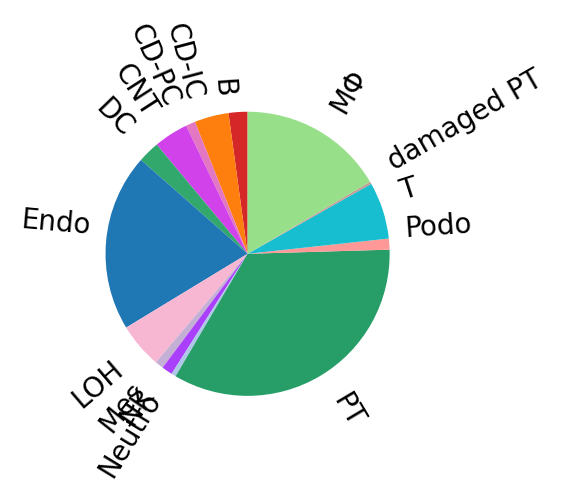

In [41]:
print("Numbers of cells per celltype:")
counts = adata_c.obs.groupby(["celltype"]).count()["sample"].reset_index()
counts = counts.sort_values("celltype")
print("others (smaller groups): ")
print(counts[(counts['sample'] < 5)])
counts.columns = ["celltype","cells"]
counts.index = counts.celltype
counts['%'] = ((counts['cells'] / counts['cells'].sum())*100).round(2).astype(str) + '%'
print(counts)

fig1, ax1 = plt.subplots()
ax1.pie(counts["cells"], labels=counts["celltype"],rotatelabels=45, 
         startangle=90, colors=[colors[d] for d in counts["celltype"]], textprops={'fontsize': 10})
ax1.axis('equal')  
#plt.savefig( config["PATHS"]["OUTPUT"]+"figs/sc_piechart_Control.png", facecolor = 'white', dpi=600, bbox_inches='tight')
plt.tight_layout()
plt.show()

### 17min

In [42]:
adata_17 = adata[adata.obs.sample_description =="cell_17min"] 

... storing 'celltype' as categorical


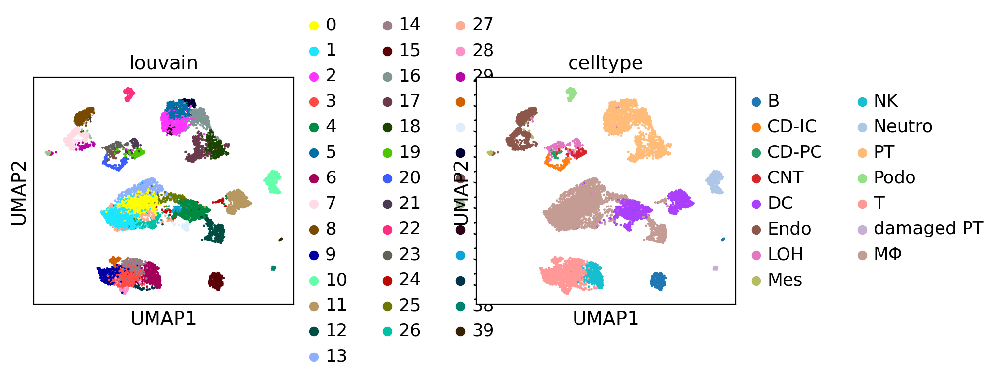

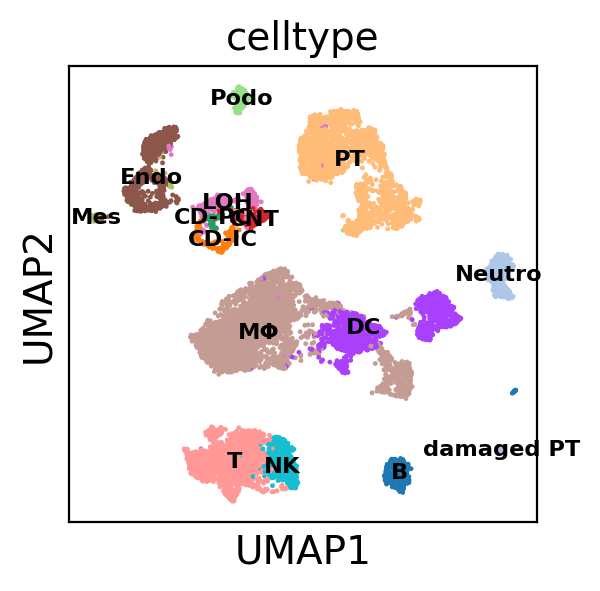

In [43]:
sc.tl.pca(adata_17, svd_solver='arpack')
sc.pp.neighbors(adata_17)
sc.tl.umap(adata_17)
sc.pl.umap(adata_17,color=["louvain","celltype"],wspace=0.55)
sc.pl.umap(adata_17 ,color=["celltype"],wspace=0.55,legend_loc ="on data",
 legend_fontsize ="xx-small")#, save="_sc_17.pdf")

Numbers of cells per celltype:
others (smaller groups): 
Empty DataFrame
Columns: [celltype, sample]
Index: []
              celltype  cells       %
celltype                             
B                    B    321   3.24%
CD-IC            CD-IC    148    1.5%
CD-PC            CD-PC     42   0.42%
CNT                CNT    135   1.36%
DC                  DC   1147  11.59%
Endo              Endo    689   6.96%
LOH                LOH    228    2.3%
Mes                Mes     40    0.4%
NK                  NK    367   3.71%
Neutro          Neutro    298   3.01%
PT                  PT   1807  18.26%
Podo              Podo    127   1.28%
T                    T   1278  12.92%
damaged PT  damaged PT     38   0.38%
ΜΦ                  ΜΦ   3229  32.64%


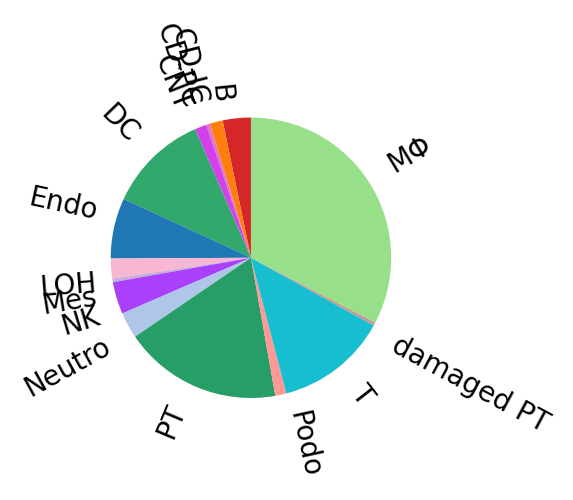

In [44]:
print("Numbers of cells per celltype:")
counts = adata_17.obs.groupby(["celltype"]).count()["sample"].reset_index()
counts = counts.sort_values("celltype")
print("others (smaller groups): ")
print(counts[(counts['sample'] < 5)])
counts.columns = ["celltype","cells"]
counts.index = counts.celltype
counts['%'] = ((counts['cells'] / counts['cells'].sum())*100).round(2).astype(str) + '%'
print(counts)

fig1, ax1 = plt.subplots()
ax1.pie(counts["cells"], labels=counts["celltype"],rotatelabels=45, 
         startangle=90, colors=[colors[d] for d in counts["celltype"]], textprops={'fontsize': 10})
ax1.axis('equal')  
#plt.savefig( config["PATHS"]["OUTPUT"]+"/figs/sc_piechart_17.png",facecolor = 'white', dpi=600, bbox_inches='tight')
plt.tight_layout()
plt.show()

### 27min

In [45]:
adata_27 = adata[adata.obs.sample_description =="cells_27min"]

... storing 'celltype' as categorical


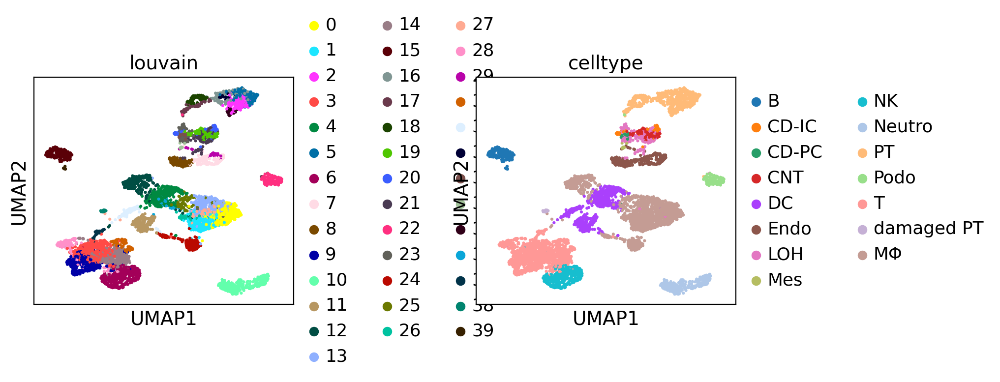

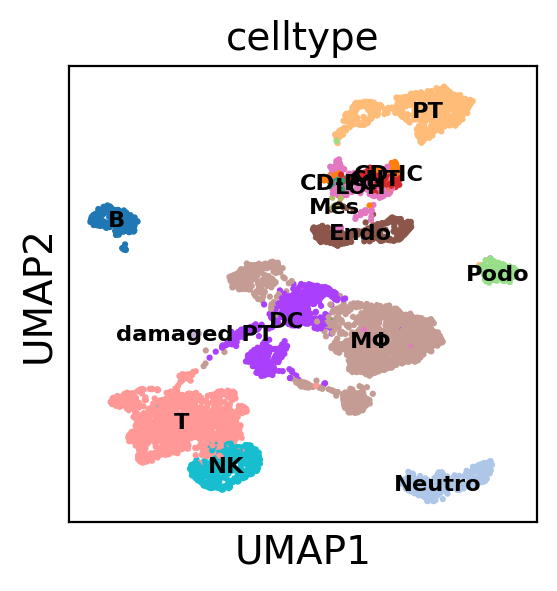

In [46]:
sc.tl.pca(adata_27, svd_solver='arpack')
sc.pp.neighbors(adata_27)
sc.tl.umap(adata_27)
sc.pl.umap(adata_27,color=["louvain","celltype"],wspace=0.55)
sc.pl.umap(adata_27 ,color=["celltype"],wspace=0.55,legend_loc ="on data",
 legend_fontsize ="xx-small")#, save="_sc_27.pdf")

Numbers of cells per celltype:
others (smaller groups): 
Empty DataFrame
Columns: [celltype, sample]
Index: []
              celltype  cells       %
celltype                             
B                    B    252   4.25%
CD-IC            CD-IC     45   0.76%
CD-PC            CD-PC     21   0.35%
CNT                CNT    123   2.07%
DC                  DC    627  10.58%
Endo              Endo    297   5.01%
LOH                LOH    182   3.07%
Mes                Mes     16   0.27%
NK                  NK    400   6.75%
Neutro          Neutro    358   6.04%
PT                  PT    604  10.19%
Podo              Podo    114   1.92%
T                    T   1260  21.25%
damaged PT  damaged PT     26   0.44%
ΜΦ                  ΜΦ   1604  27.05%


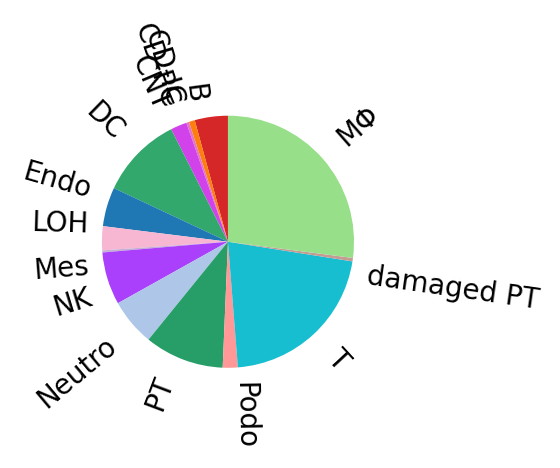

In [47]:
print("Numbers of cells per celltype:")
counts = adata_27.obs.groupby(["celltype"]).count()["sample"].reset_index()
counts = counts.sort_values("celltype")
print("others (smaller groups): ")
print(counts[(counts['sample'] < 5)])
counts.columns = ["celltype","cells"]
counts.index = counts.celltype
counts['%'] = ((counts['cells'] / counts['cells'].sum())*100).round(2).astype(str) + '%'
print(counts)

fig1, ax1 = plt.subplots()
ax1.pie(counts["cells"], labels=counts["celltype"],rotatelabels=45, 
         startangle=90, colors=[colors[d] for d in counts["celltype"]], textprops={'fontsize': 10})
ax1.axis('equal')  
#plt.savefig( config["PATHS"]["OUTPUT"]+"/figs/sc_piechart_27.png",facecolor = 'white',dpi=600,bbox_inches='tight')
plt.tight_layout()
plt.show()

# PT cells

In [48]:
pt= ["PT","damaged PT"]
adata_pt = adata[adata.obs['celltype'].isin(pt)]

In [49]:
adata_pt.obs["sample_description"] = adata_pt.obs["sample_description"].str.replace("cell_","")
adata_pt.obs["sample_description"] = adata_pt.obs["sample_description"].str.replace("cells_","")
adata_pt.obs["sample_description"] = adata_pt.obs["sample_description"].astype('category')
adata_pt.obs["sample_description"] = adata_pt.obs["sample_description"].cat.reorder_categories(['control','17min','27min'])

Trying to set attribute `.obs` of view, copying.


In [50]:
sc.tl.pca(adata_pt, svd_solver='arpack')
sc.pp.neighbors(adata_pt, n_neighbors=5, n_pcs=20)
sc.tl.louvain(adata_pt, resolution=0.4)
sc.tl.louvain(adata_pt, key_added='louvain_rdef')
print("number of clusters:", len(np.unique(adata_pt.obs["louvain"])))
sc.tl.umap(adata_pt)

number of clusters: 12


In [51]:
#adata_pt.write(config["PATHS"]["OUTPUT"]+"/sc_pt_newUmap.h5ad")

... storing 'celltype' as categorical


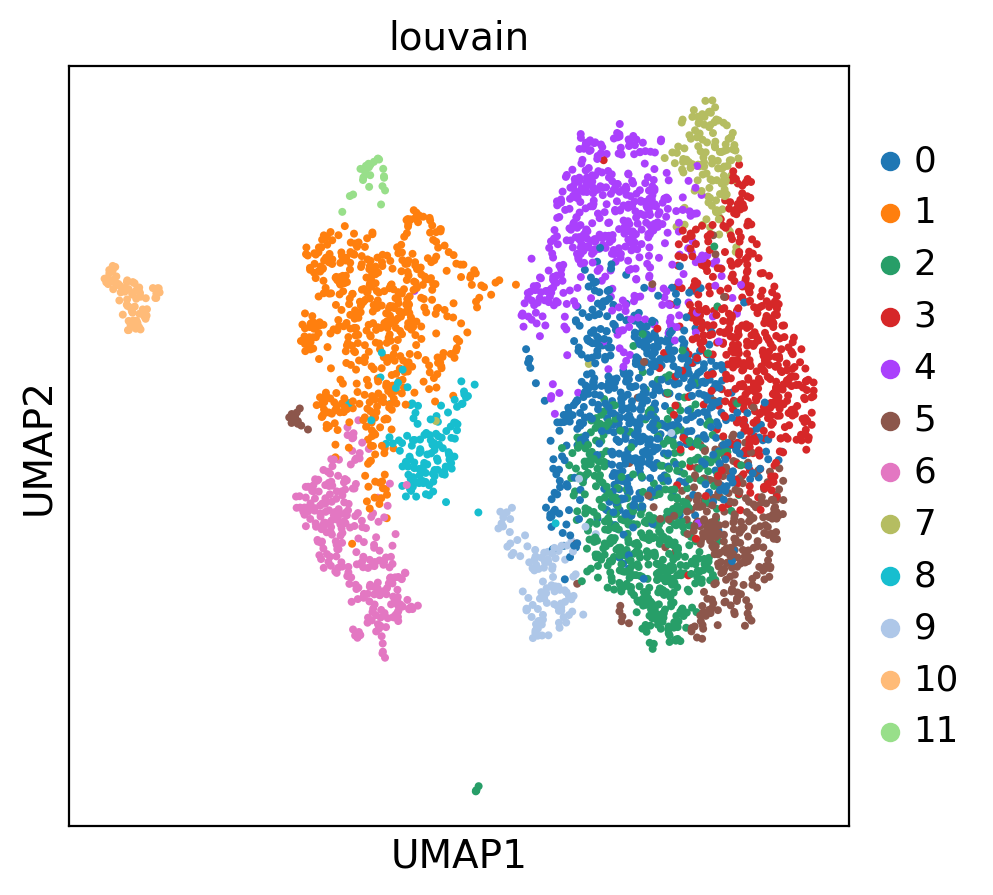

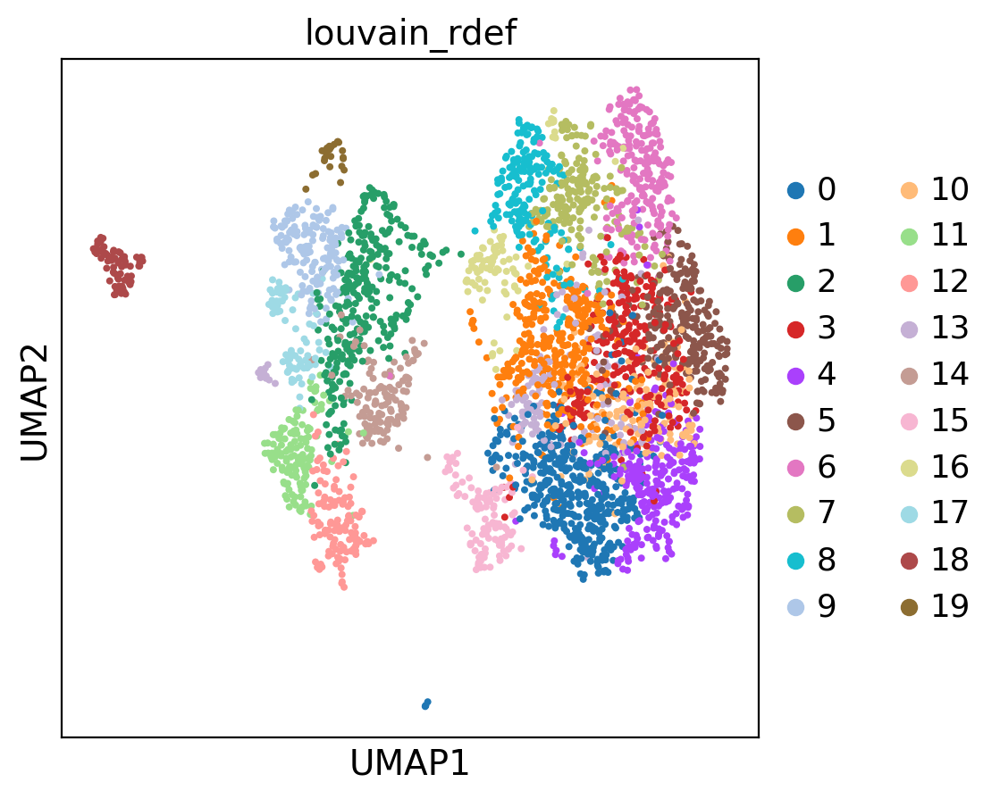

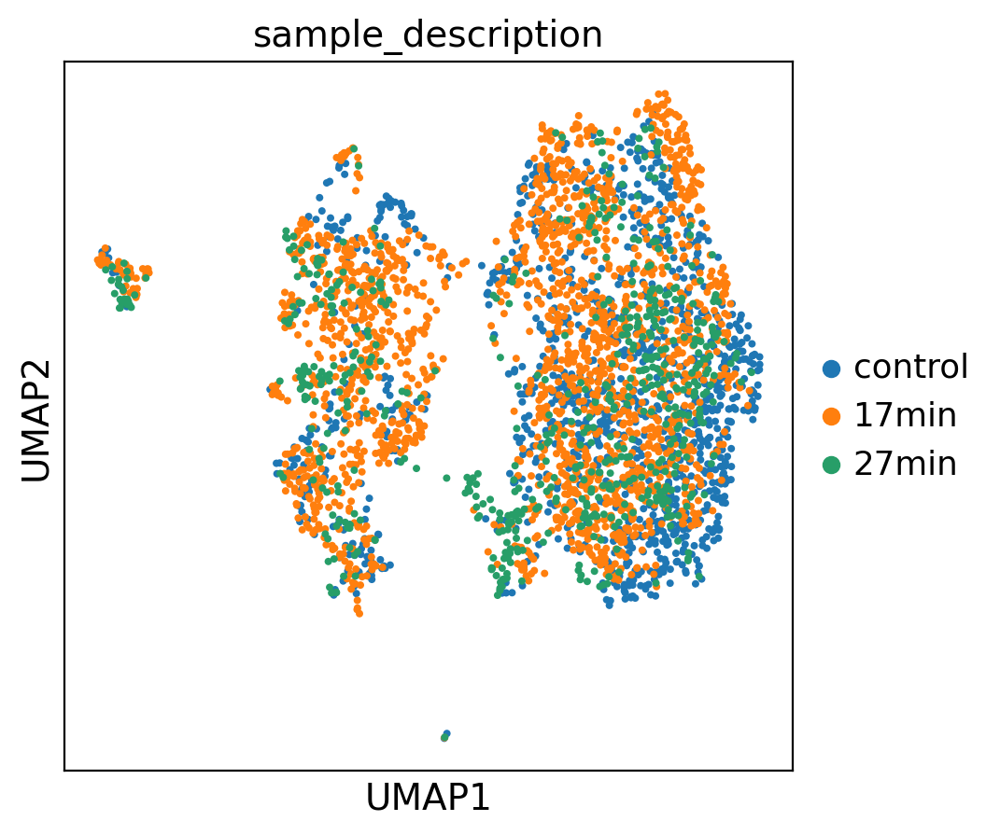

In [52]:
rcParams['figure.figsize'] = 5,5
sc.pl.umap(adata_pt, color=['louvain'], wspace=0.3)#, save="_sc_pt_clusters.png")
sc.pl.umap(adata_pt, color=['louvain_rdef'], wspace=0.3)
sc.pl.umap(adata_pt, color=['sample_description'], wspace=0.3)#, save="_sc_pt_samples.png")

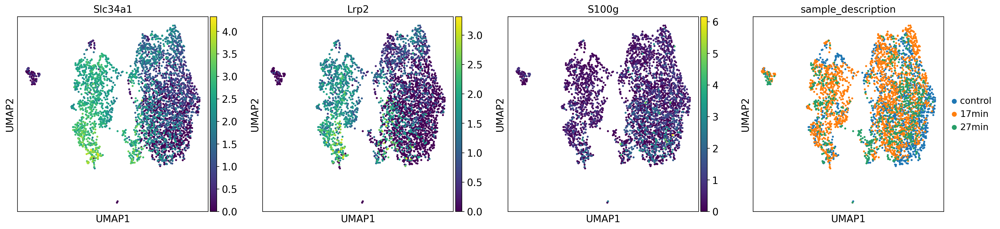

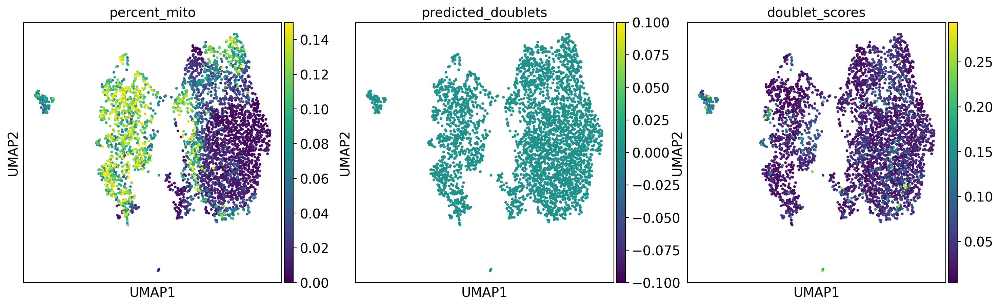

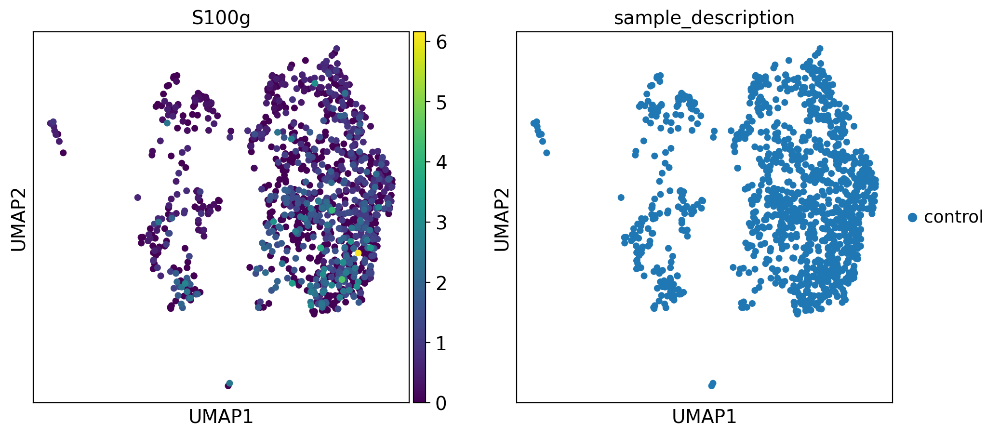

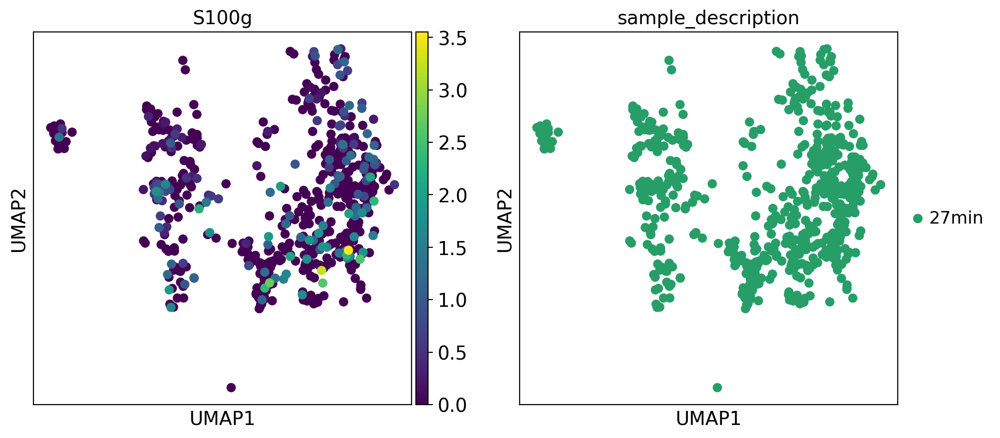

In [53]:
sc.pl.umap(adata_pt, color=["Slc34a1","Lrp2",'S100g', "sample_description"])
sc.pl.umap(adata_pt, color=['percent_mito', 'predicted_doublets', 'doublet_scores'])
sc.pl.umap(adata_pt[adata_pt.obs.sample_description == "control"], color=['S100g', "sample_description"])
sc.pl.umap(adata_pt[adata_pt.obs.sample_description == "27min"], color=['S100g', "sample_description"])

## plot percent mito and gene expression of known PT-subgroup marker genes

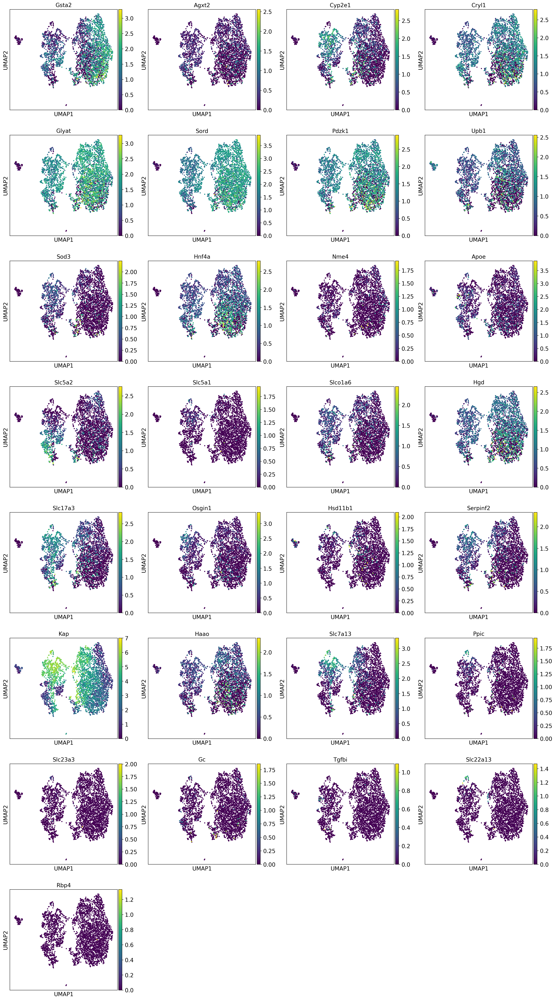

In [54]:
markergenes_dict =  {'Proximal (General)': ["Gsta2","Agxt2","Cyp2e1","Cryl1","Glyat","Sord","Pdzk1","Upb1","Sod3","Hnf4a"],
               'Proximal (S1)':  ['Nme4',"Apoe","Slc5a2"],
               'Proximal (S2)': ["Slc5a1","Slco1a6","Hgd","Slc17a3","Osgin1","Hsd11b1","Serpinf2","Kap","Haao",
                                 "Slc7a13","Ppic"],
               'Proximal (S3)': ["Tff3","Gng13","Slc23a3","Gc","Cacng5","Tgfbi","Slc22a13","Rbp4"]}
markergenes = ["Gsta2","Agxt2","Cyp2e1","Cryl1","Glyat","Sord","Pdzk1","Upb1","Sod3","Hnf4a",'Nme4',"Apoe","Slc5a2",
               "Slc5a1","Slco1a6","Hgd","Slc17a3","Osgin1","Hsd11b1","Serpinf2","Kap","Haao", "Slc7a13","Ppic",
               "Slc23a3","Gc","Tgfbi","Slc22a13","Rbp4"]

sc.pl.umap(adata_pt, color=markergenes, legend_loc='on data')

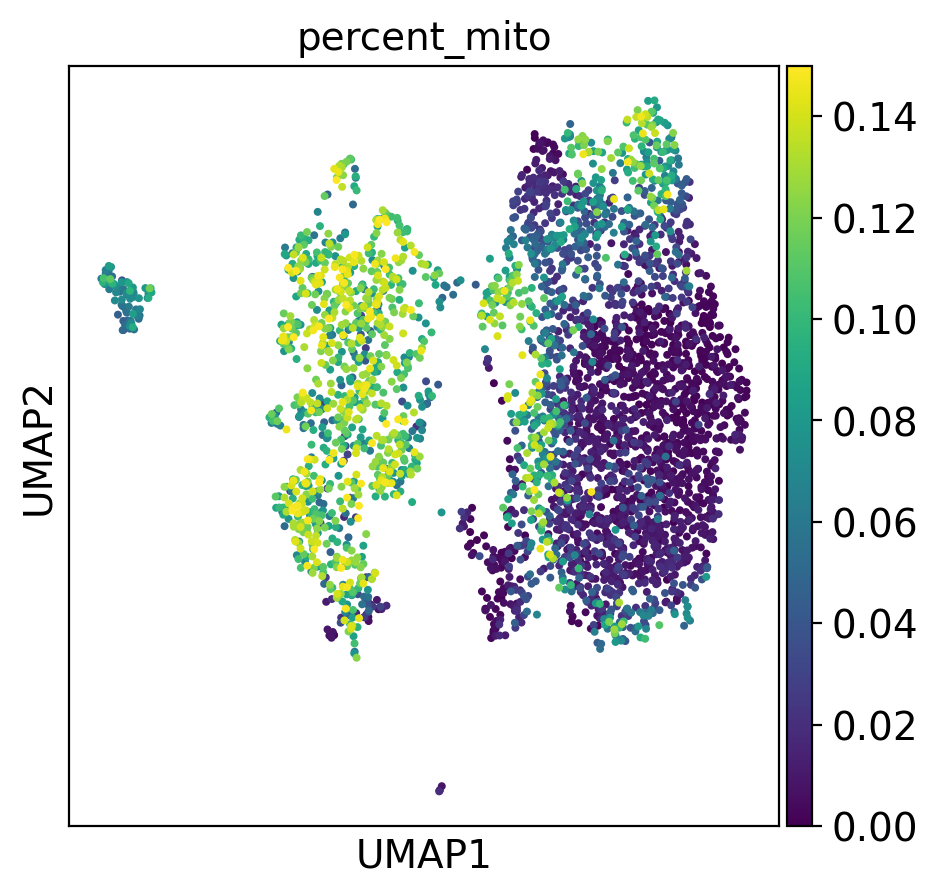

In [55]:
sc.pl.umap(adata_pt, color="percent_mito", legend_loc='on data')

-> no batch effect  for mt expression

In [56]:
adata_pt.obs['louvain'].value_counts()

0     626
1     529
2     523
3     500
4     459
5     299
6     262
7     126
8     122
9     108
10     73
11     24
Name: louvain, dtype: int64

## identify markergenes for louvain clusters

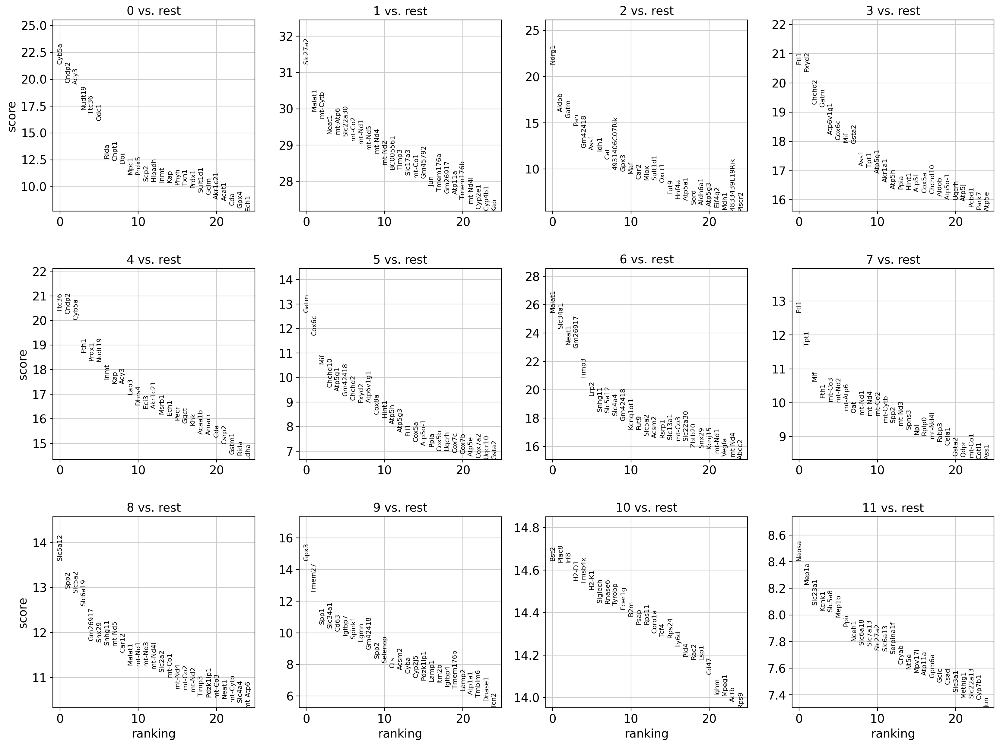

['Slc27a2', 'Neat1', 'Gm42418', 'Plac8', 'Malat1', 'Slc5a12', 'Atp6v1g1', 'Aldob', 'Cox6c', 'Slc5a2', 'Gm26917', 'Gatm', 'Tmsb4x', 'Cd63', 'mt-Cytb', 'Tpt1', 'Ndrg1', 'Chchd10', 'Kcnk1', 'Acy3', 'Prdx1', 'mt-Atp6', 'Fxyd2', 'Slc6a19', 'Tmem27', 'Slc34a1', 'Ttc36', 'Atp5g1', 'Slc5a8', 'Fth1', 'Irf8', 'Napsa', 'Slc23a1', 'Gpx3', 'Nudt19', 'Spp2', 'Mif', 'Chchd2', 'Cyb5a', 'Ftl1', 'Cndp2', 'Timp3', 'Mep1a', 'Spp1', 'mt-Co3', 'H2-D1', 'Pah', 'Bst2']


In [57]:
sc.tl.rank_genes_groups(adata_pt, 'louvain', method='wilcoxon')
sc.pl.rank_genes_groups(adata_pt, n_genes=25, sharey=False)

marker_genes = pd.DataFrame(adata_pt.uns['rank_genes_groups']['names']).head(5).values.flatten().tolist()
marker_genes = list(set(marker_genes))
print(marker_genes)

# Save Notebook as html

In [58]:
%%bash
jupyter nbconvert --to html_toc script_sc_20211022_resolution13.ipynb --ExtractOutputPreprocessor.enabled=False
#mv script_sc_20200908.html ./results/script_sc_20200908.html 

[NbConvertApp] Converting notebook script_sc_20211022_resolution13.ipynb to html_toc
[NbConvertApp] Writing 7922183 bytes to script_sc_20211022_resolution13.html
